## STEP 06: Model Training

### Import Necessary Libraries

In [1]:
import pandas as pd
import numpy as np
import os
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
import plotly.express as px
from sklearn.manifold import TSNE

import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
import numpy as np

import warnings
warnings.filterwarnings("ignore")

## 6.1 Load datasets from file paths

In [3]:
data_path = '..\Dataset\data_cleaned.csv'
genre_data_path = '..\Dataset\genre_data_cleaned.csv'

# Check if files exist and load them
if os.path.exists(data_path) and os.path.exists(genre_data_path):
    data = pd.read_csv(data_path)
    genre_data = pd.read_csv(genre_data_path)
    print("Info: Data and genre data successfully loaded.")
else:
    print("Attention: One or both files are not found in the specified directory.")

Info: Data and genre data successfully loaded.


## 6.2 Clustering Genres with K-Means

Using K-Means, we aim to identify clear groups of genres, understand their similarities, and leverage this understanding to enhance how we recommend music by tailoring suggestions more closely to user tastes.

####  K-Means is chosen for clustering due to several advantages mentioned below:
- **Efficiency**: K-Means is well-suited for large datasets, which is typical for music data, ensuring the process is manageable and fast.
- **Simplicity**: The implementation of K-Means is straightforward making the setup quick and the results easy to interpret.
- **Effectiveness**: K-Means excels at creating distinct groups or clusters where each genre group shares similar attributes. This is particularly useful in scenarios where genres form clear, spherical groups in feature space.
!![link text](https://labcontent.simplicdn.net/data-content/content-assets/Data_and_AI/ML/New/Lesson_06_Unsupervised_Learning/kmeans.png)

![link text](https://labcontent.simplicdn.net/data-content/content-assets/Data_and_AI/ML/New/Lesson_06_Unsupervised_Learning/working_of_kmeans.png)

#### 6.2.1 Clustering Pipeline Preparation

In [6]:
X = genre_data.select_dtypes(include=np.number) 

**Prepare the clustering pipeline with a scaler and KMeans clustering**
- The StandardScaler standardizes features by removing the mean and scaling each feature to unit variance.
- This normalization ensures that no single feature dominates the distance calculations, which is important for achieving fair clustering.
- KMeans algorithm partitions the data into optimal number of clusters computed above

In [8]:
cluster_pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Standardize data (zero mean, unit variance)
    ('kmeans', KMeans(             # Apply K-Means clustering
        n_clusters=13,             # Number of clusters
        init='k-means++',          # Smart centroid initialization
        n_init=10,                 # Number of different initializations
        max_iter=300,              # Max iterations for convergence
        tol=0.001,                 # Convergence tolerance
        random_state=42            # Ensure reproducibility
    ))
])
display(cluster_pipeline)
print("info: Clustering pipeline prepared.")

Pipeline(steps=[('scaler', StandardScaler()),
                ('kmeans',
                 KMeans(n_clusters=13, n_init=10, random_state=42, tol=0.001))])

info: Clustering pipeline prepared.


#### 6.2.2 Fitting the Clustering Pipeline

In [10]:
genre_data['cluster'] = cluster_pipeline.fit_predict(X)
display(genre_data['cluster'])
print("info: Clustering completed. Cluster labels assigned to the data.")

0        8
1        6
2        5
3        2
4       11
        ..
2968     5
2969    10
2970     5
2971     2
2972     5
Name: cluster, Length: 2973, dtype: int32

info: Clustering completed. Cluster labels assigned to the data.


#### 6.2.3 t-SNE Pipeline Preparation

**TSNE: t-Distributed Stochastic Neighbor Embedding (t-SNE)** 
- This is a technique for reducing the dimensionality of data to two dimensions (n_components=2) for the purpose of visualization. 
- It is  particularly well-suited for the visualization of high-dimensional datasets. 

In [13]:
tsne_pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Standardize the data (zero mean, unit variance)
    ('tsne', TSNE(                 # Apply t-SNE for dimensionality reduction
        n_components=2,            # Reduce data to 2 dimensions for visualization
        perplexity=50,             # Balance focus between local and global relationships
        learning_rate=300,         # Controls optimization step size
        max_iter=2000,             # Number of iterations for convergence
        early_exaggeration=6,      # Enhances cluster separability in early stages
        verbose=1,                 # Enable progress output
        random_state=42            # Ensure reproducibility of results
    ))
])

#### 6.2.4 Applying t-SNE Pipeline

In [16]:
genre_embedding = tsne_pipeline.fit_transform(X)
print("Dimensionality reduction with t-SNE completed.")

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.005s...
[t-SNE] Computed neighbors for 2973 samples in 0.560s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.871339
[t-SNE] KL divergence after 250 iterations with early exaggeration: 29.186110
[t-SNE] KL divergence after 2000 iterations: 1.289757
Dimensionality reduction with t-SNE completed.


**Conclusion**

- The significant drop in KL divergence from 29.19 (after 250 iterations) to 1.29 (after 2000 iterations) indicates that the algorithm has effectively captured the underlying structure of the data in the reduced dimensions.
- The mean sigma value of 0.871 suggests that the spread of data points in the high-dimensional space is relatively consistent, allowing t-SNE to maintain meaningful distances between similar points in the final plot.

**Summary**
- The t-SNE algorithm has successfully reduced the high-dimensional data to 2D while preserving the relationships between data points.
- This 2D representation provides a more understandable view of complex, high-dimensional data, making it easier to identify meaningful structures, trends, and clusters.

#### 6.2.5 DataFrame Creation for Visualization

In [18]:
projection = pd.DataFrame(genre_embedding, columns=['x', 'y'])
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']
print("Data prepared for plotting.")
display(projection)

Data prepared for plotting.


,x,y,genres,cluster
0,-53.985283,-13.908666,21st century classical,8
1,-37.638294,-22.635458,432hz,6
2,-15.282907,39.108910,8-bit,5
3,-32.433784,13.988687,[],2
4,-12.161901,2.526990,a cappella,11
...,...,...,...,...
2968,16.412006,-2.640091,zolo,5
2969,-9.565117,-66.927483,zouglou,10
2970,11.491752,42.381573,zouk,5
2971,-40.134327,26.134970,zurich indie,2


#### 6.2.6 Plot : Clustering Genres with K-Means

Displaying the plot.


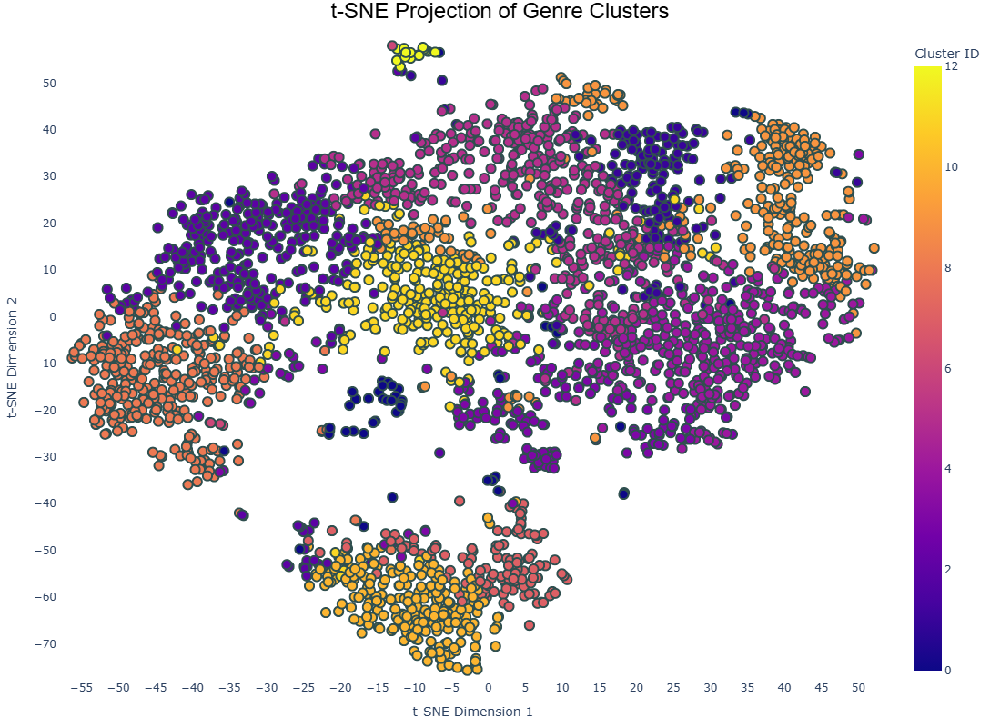

In [20]:
fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['genres'],
    title='t-SNE Projection of Genre Clusters',  # Add a descriptive title
    labels={'cluster': 'Cluster ID', 'x': 't-SNE Dimension 1', 'y': 't-SNE Dimension 2'}, 
    color_continuous_scale=px.colors.sequential.Plasma
)

# Adjust the size of the markers to make them clearer
fig.update_traces(
    marker=dict(
        size=10,  # Larger marker size
        line=dict(width=2, color='DarkSlateGrey')  
    ),
    selector=dict(mode='markers')
)

fig.update_layout(
    title=dict(x=0.5, xanchor='center', font=dict(size=24, family="Arial", color='black')),  
    legend_title=dict(font=dict(size=18, family="Arial", color='black')), 
    legend=dict(
        font=dict(size=16),           # Make legend text larger for readability
        title_font_size=18,           # Set the title size of the legend
        x=1.05,                       # Position the legend further out to the right
        xanchor='left',               # Anchor legend to the left side
        y=1,                          # Position the legend at the top of the plot
        yanchor='top'                 # Anchor the legend to the top
    ),
    xaxis=dict(
        range=[projection['x'].min() - 2, projection['x'].max() + 2],  # Extend x-axis to make room for points
        tickmode='linear',                                             # Ensure ticks are evenly spaced
        tick0=5,                                                       # Start the ticks at 5
        dtick=5                                                        # Set tick interval to 5
    ),
    yaxis=dict(
        range=[projection['y'].min() - 2, projection['y'].max() + 2],  # Extend y-axis to make room for points
        tickmode='linear',                                             # Ensure ticks are evenly spaced
        tick0=10,                                                      # Start the ticks at 10
        dtick=10                                                       # Set tick interval to 10
    ),
    width=1000,                       # Width of the plot
    height=800,                       # Height of the plot
    margin=dict(l=40, r=40, t=40, b=40),        # Reduce margins for more space
    plot_bgcolor='white',                       # Set the background color to white for better contrast
    showlegend=True                             # Ensure the legend is visible
)

# Display the plot
print("Displaying the plot.")
fig.show()



#### Conclusions

This t-SNE plot represents clusters of genres, providing insights into the similarity and separability of the data based on a clustering algorithm.
This visualization is well-suited for exploring the structure of the t-SNE embedding and analyzing genre clusters. 

**Clusters Representation**
- The data points are grouped into clusters, represented by distinct colors corresponding to the "Cluster ID" scale on the right.
- There are 13 clusters (0–12), as indicated by the color bar.

**Distribution**
- Clusters are distributed across the 2D t-SNE space, showing how the data is separated into distinct groups.
- Some clusters (e.g., orange and yellow regions) are tightly packed, indicating strong similarities within those groups.
- Other clusters (e.g., darker purple regions) are more spread out, suggesting greater variability within those groups.
- Clear boundaries are visible between most clusters, demonstrating that the t-SNE algorithm has effectively separated the data points into distinct groups.
- However, there is some overlap between neighboring clusters (e.g., purple and orange regions), which might suggest either slight similarities or the presence of edge cases in the data.

**t-SNE Dimensions**
- The x-axis (t-SNE Dimension 1) and y-axis (t-SNE Dimension 2) are abstract dimensions, derived from reducing the data's original features to 2D.
- The spread along both axes indicates meaningful separations in the high-dimensional space.

**Summary**
-  Clear separations in the plot can be leveraged for personalized recommendations. Items from well-separated clusters can target users with distinct preferences.



In [26]:
cluster_summary = genre_data.groupby('cluster').size().reset_index(name='total_genres')
display(cluster_summary.T)

,0,1,2,3,4,5,6,7,8,9,10,11,12
cluster,0,1,2,3,4,5,6,7,8,9,10,11,12
total_genres,58,167,335,182,385,443,6,143,340,349,248,297,20


#### Conclusions

cluster: Cluster IDs (e.g., 0, 1, 2, ..., 12).
total_genres: The total number of genres assigned to each cluster.

**Clusters with Most Genres**
* Cluster 5: Contains 443 genres, making it the largest cluster. 

**Clusters with Least Genres**
* Cluster 6: Contains 6 genres, very small group.

**Summary**:
* Highly Populated Clusters: Clusters 4, 5, 8 and 9 dominate with the most genres, indicating these clusters represent the most common groupings or genres with significant overlap.
* Sparse Clusters: Clusters 6 and 12 are outliers, with very few genres. These may represent niche or unique categories.
* Cluster Diversity: The uneven distribution across clusters highlights varying densities and potential differences in genre similarity.


### 6.3 CLUSTERING SONGS WITH K-MEANS

#### 6.3.1 Clustering Pipline Preparation

- Combines scaling and clustering into a single pipeline for streamlined execution.
- The pipeline efficiently standardizes features and applies k-means clustering with robust settings for stability, reproducibility, and convergence. 
- Designed for efficient and reproducible clustering of song data into 11 clusters.

In [29]:
song_cluster_pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Standardize the features for fair distance calculations
    ('kmeans', KMeans(
        n_clusters=11,             # Number of clusters
        init='k-means++',          # Improved centroid initialization
        n_init=10,                 # Number of runs with different centroid seeds
        max_iter=300,              # Maximum number of iterations for a single run
        tol=0.0001,                # Convergence tolerance
        verbose=1,                 # Enable verbose output to monitor progress
        random_state=42            # Ensure reproducibility
    ))
], verbose=False)

#### 6.3.2 Fitting the Clustering Pipeline

In [31]:
Y = data.select_dtypes(np.number)
data['cluster_label'] = song_cluster_pipeline.fit_predict(Y)

Initialization complete
Iteration 0, inertia 2186972.3993087276.
Iteration 1, inertia 1664697.6057401837.
Iteration 2, inertia 1581167.5214596137.
Iteration 3, inertia 1526335.1982496565.
Iteration 4, inertia 1511756.4248445127.
Iteration 5, inertia 1502798.3852442217.
Iteration 6, inertia 1493830.317225972.
Iteration 7, inertia 1485851.025957281.
Iteration 8, inertia 1480185.5005372623.
Iteration 9, inertia 1475651.3070063065.
Iteration 10, inertia 1471021.989580808.
Iteration 11, inertia 1466366.2896863231.
Iteration 12, inertia 1462346.2280598735.
Iteration 13, inertia 1459520.063407633.
Iteration 14, inertia 1457740.2969321143.
Iteration 15, inertia 1456719.55415703.
Iteration 16, inertia 1456109.2801621298.
Iteration 17, inertia 1455672.1575362685.
Iteration 18, inertia 1455331.495084925.
Iteration 19, inertia 1455083.561133267.
Iteration 20, inertia 1454901.4826017066.
Iteration 21, inertia 1454776.3566089447.
Iteration 22, inertia 1454679.3955718162.
Iteration 23, inertia 145459

#### Conclusions
- Model Stability: The algorithm converged after 31 iterations, meaning it found the optimal cluster centers within the set tolerance indicating that the model has effectively clustered the data and is not overfitting or underfitting.
- Cluster Tightness: The steady decrease in inertia suggests that the clusters are becoming tighter (i.e., the points are getting closer to their respective centroids), which is desirable in clustering tasks.

#### 6.3.3 PCA Pipeline Preparation

- This pipeline first standardizes the data and then applies PCA to reduce the dataset to two dimensions, making it easier to visualize and analyze.

In [33]:
# Define a pipeline for PCA-based dimensionality reduction
pca_pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Step 1: Standardize the features (zero mean, unit variance)
    ('PCA', PCA(                   # Step 2: Apply PCA for dimensionality reduction
        n_components=2,            # Reduce to 2 principal components
        svd_solver='auto',         # Automatically selects the best solver for computation
        whiten=True,               # Normalize components to remove scale differences
        tol=0.0001,                # Convergence tolerance for the solver
        random_state=42            # Ensure reproducibility of the results
    ))
])


#### 6.3.4 Applying PCA Pipeline

In [35]:
song_embedding = pca_pipeline.fit_transform(Y)

In [37]:
projection = pd.DataFrame(song_embedding, columns=['x', 'y'])
projection['title'] = data['name']  
projection['cluster'] = data['cluster_label']

#### 6.3.5 Plot: Clustering Songs with K-Means

In [9]:
import plotly.express as px

fig = px.scatter(
    
    projection, x='x', y='y', color='cluster', hover_data=['title'],
    title='PCA Projection of Song Clusters',  
    labels={'cluster': 'Cluster'},  
    color_continuous_scale=px.colors.sequential.Plasma  
)

fig.update_traces(
    marker=dict(
        size=6, 
        line=dict(width=2, color='DarkSlateGrey')  
    ),
    selector=dict(mode='markers')
)

fig.update_layout(
    title=dict(x=0.5, xanchor='center', font=dict(size=24, family="Arial", color='black')),  
    legend_title=dict(font=dict(size=16, family="Arial", color='black')), 
    legend=dict(
        font=dict(size=14),                         # Increase font size of legend items for better readability
        title_font_size=16,                         # Set title font size of the legend
        x=1.05,                                     # Position the legend further out to the right
        xanchor='left',                             # Anchor the legend to the left side of its position
        y=1,                                        # Position the legend at the top of the plot
        yanchor='top'                               # Anchor the legend to the top
    ),
    xaxis=dict(
        range=[projection['x'].min() - 2, projection['x'].max() + 2],   # Extend x-axis range to make room for all points
        tickmode='linear',                                              # Ensure the ticks are evenly spaced
        tick0=5,                                                        # Start ticks at 5
        dtick=5                                                         # Set tick interval to 5
    ),
    yaxis=dict(
        range=[projection['y'].min() - 2, projection['y'].max() + 2],   # Extend y-axis range to make room for all points
        tickmode='linear',                                              # Ensure the ticks are evenly spaced
        tick0=10,                                                       # Start ticks at 10
        dtick=10                                                        # Set tick interval to 10
    ),
    width=1000,                                                         # Set width of the plot
    height=800,                                                         # Set height of the plot
    margin=dict(l=40, r=40, t=40, b=40),                                # Reduce margins for more space
    plot_bgcolor='white',                                               # Set the background color to white for better contrast
    showlegend=True  
)
print("Displaying the plot.")
fig.show()


Displaying the plot.


#### Conclusions
- This PCA plot illustrates the clustering of songs based on their features, providing insights into the data's structure after dimensionality reduction.

**Clusters Representation**
- The data points are grouped into clusters, with each cluster assigned a distinct color, shown in the "Cluster ID" scale on the right.
- The clusters are numbered from 0 to 10, indicating a total of 11 distinct clusters in the dataset.

**Distribution**
-The clusters are distributed across the 2D PCA space, showing how songs are grouped based on their feature similarity.
- Some clusters (e.g., the dense regions on the upper-right side) are tightly packed, suggesting strong similarities among the songs within these groups.
- Other clusters (e.g., towards the bottom of the plot) are more dispersed, indicating greater variability within those groups.
- Clear separations are visible between most clusters, which highlights that PCA has effectively reduced the data's dimensions while maintaining the distinctiveness of each cluster.
- A few outliers or isolated points (e.g., around the lower-left area) might indicate songs that don’t fit well within the identified clusters.

**PCA Dimensions**
- The x-axis (Principal Component 1) and y-axis (Principal Component 2) represent the most significant components after the dimensionality reduction.
- The spread along both axes reflects the variance captured by the first two principal components, helping to visualize how songs from different clusters are separated in the reduced space.

**Summary**
- The clear separations between most clusters suggest that songs in different groups are sufficiently distinct based on their features.
- These clusters can be used to personalize recommendations for users, targeting songs with specific features or patterns based on preferences, genre, or other attributes.


In [40]:
cluster_summary = data.groupby('cluster_label').size().reset_index(name='total_songs')
display(cluster_summary.T)

,0,1,2,3,4,5,6,7,8,9,10
cluster_label,0,1,2,3,4,5,6,7,8,9,10
total_songs,39151,26041,21076,8177,3166,11735,16333,21289,4958,17141,1586


#### Conclusions
**Clusters**
- Cluster labels range from 0 to 10, corresponding to 11 clusters in total.
- Total Songs in Each Cluster: The number of songs assigned to each cluster varies significantly.

**Clusters with Most Songs**
Cluster 0: Contains 39,151 songs, making it the largest cluster.

**Clusters with Least Songs**
Cluster 10: Contains only 1,586 songs, the smallest cluster.

**Summary**
- Highly Populated Clusters: Clusters 0, 1, and 2 dominate with the highest number of songs, suggesting that these clusters represent more general or widely distributed categories.
- Sparse Clusters: Clusters 4 and 10 have very few songs, with Cluster 10 being particularly sparse. These may represent niche or less common song categories.
- Cluster Distribution: The varying song counts across clusters indicate diverse groupings, with some clusters being more populated, possibly reflecting more common genres or songs with overlapping features. Others are smaller, suggesting that these could represent unique or specialized song categories.

### 6.4 Conclusion: Simplifying Music Recommendations Through Clusters

**Understanding Our Data:**
- Our analysis shows that songs from the same genre group together in our dataset.
- This pattern is clear and expected, as songs within a genre typically share many features like beat, instruments, and even the era they're from.

**Why This Matters:**
- This grouping is great for making music recommendations. If you like a particular song, chances are you'll enjoy other songs
that are close to it in our dataset. These songs aren't just similar in sound—they share a style and vibe that appeal to the same taste.

**How We Use This for Better Recommendations:**
- We can use this information to suggest songs that you are likely to enjoy. By looking at the songs you've listened to and loved,
- our system finds other songs from the same cluster and recommends them to you. It's like having a smart DJ who knows exactly
what you like and what to play next.

**This isn't about guessing what you might like; it's about using data to find perfect matches based on your previous choices.
The result? Every song suggestion feels personal and just right for your musical preferences.**


### 6.5 Store the pre-processed dataset

In [43]:
data.to_csv('..\Dataset\data_cleaned_clustering.csv', index=False)  
genre_data.to_csv('..\Dataset\genre_data_cleaned_clustering.csv', index=False) 